<a href="https://colab.research.google.com/github/chatwipa-sur/SRCC_detection/blob/main/Model_usage.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Model Usage
- The example how to use the trained model


In [1]:
# Standard library for file and directory operations
import os
from datetime import datetime
import sys

# Library for parsing XML files (used for annotations)
import xml.etree.ElementTree as ET

# Core PyTorch library for tensor operations
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.transforms.functional as F
from torchvision.transforms.functional import to_pil_image
from torch.utils.data import random_split
import torch.nn as nn
import torchvision
from torchvision.ops import nms, box_iou
from torchvision.models import ResNet50_Weights, ResNet34_Weights, ResNet18_Weights
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Library for numerical computations
import numpy as np
from scipy.ndimage import maximum_filter
import pandas as pd
import time

# Library for data visualization
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

In [2]:
# Mount the drive with google colab notebook
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 1. Load model

### 1.1 Teacher Model

In [3]:
class double_conv(nn.Module):
    '''(conv => BN => ReLU) * 2'''
    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU
            nn.Dropout2d(p=0.3),

            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU
            nn.Dropout2d(p=0.3),
        )

    def forward(self, x):
        x = self.conv(x)
        return x

class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch//2, in_ch//2, 2, stride=2)
        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2=None):
        x1 = self.up(x1)
        if x2 is not None:
            x = torch.cat([x2, x1], dim=1)
            # input is CHW
            diffY = x2.size()[2] - x1.size()[2]
            diffX = x2.size()[3] - x1.size()[3]

            x1 = F.pad(x1, (diffX // 2, diffX - diffX//2,
                            diffY // 2, diffY - diffY//2))
        else:
            x = x1
        x = self.conv(x)
        return x

class centernet(nn.Module):
    def __init__(self, n_classes=1, model_name="resnet34"):
        super(centernet, self).__init__()

        # Create model backbone
        if model_name == "resnet50":
            basemodel = torchvision.models.resnet50(weights=ResNet50_Weights.DEFAULT)
            self.num_ch = 2048
        elif model_name == "resnet34":
            basemodel = torchvision.models.resnet34(weights=ResNet34_Weights.DEFAULT)
            self.num_ch = 512
        elif model_name == "resnet18":
            basemodel = torchvision.models.resnet18(weights=ResNet18_Weights.DEFAULT)
            self.num_ch = 512

        # Remove the last two layers (average pooling and linear layer)
        self.base_model = nn.Sequential(*list(basemodel.children())[:-2])

        # Freeze earlier layers except layer3 and layer4
        for name, param in basemodel.named_parameters():
            if "layer3" in name or "layer4" in name:
                param.requires_grad = True
            else:
                param.requires_grad = False

        if self.num_ch == 2048:
            self.up1 = up(self.num_ch, 1024)
            self.up2 = up(1024, 512)
            self.up3 = up(512, 256)
        else:
            self.up1 = up(self.num_ch, 512)
            self.up2 = up(512, 256)
            self.up3 = up(256, 256)

        # Output classification
        self.outc = nn.Conv2d(256, n_classes, 1)

        # Output residue
        self.outr = nn.Conv2d(256, 2, 1)

    def forward(self, x):
        x = self.base_model(x)
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        outc = self.outc(x)
        outr = self.outr(x)
        return outc, outr

In [4]:
teacher_model = centernet(model_name='resnet50')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
teacher_model.to(device)

model_path = "/content/drive/MyDrive/Dissertation_Chatwipa/model_checkpoint/adam50_checkpoints_20250627_173310/best_model.pth"
checkpoint = torch.load(model_path)
teacher_model.load_state_dict(checkpoint['model_state_dict'])

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 214MB/s]


<All keys matched successfully>

### 1.2 Baseline student model

In [5]:
class double_conv(nn.Module):
    '''(conv => BN => ReLU) * 2'''
    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU
            # nn.Dropout(0.2),

            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU
            # nn.Dropout(0.2),
        )

    def forward(self, x):
        x = self.conv(x)
        return x

class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch//2, in_ch//2, 2, stride=2)
        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2=None):
        x1 = self.up(x1)
        if x2 is not None:
            x = torch.cat([x2, x1], dim=1)
            # input is CHW
            diffY = x2.size()[2] - x1.size()[2]
            diffX = x2.size()[3] - x1.size()[3]

            x1 = F.pad(x1, (diffX // 2, diffX - diffX//2,
                            diffY // 2, diffY - diffY//2))
        else:
            x = x1
        x = self.conv(x)
        return x

class centernet(nn.Module):
    def __init__(self, n_classes=1, model_name="resnet34"):
        super(centernet, self).__init__()

        # Create model backbone
        if model_name == "resnet34":
            basemodel = torchvision.models.resnet34(weights=ResNet34_Weights.DEFAULT)
            self.num_ch = 512
        elif model_name == "resnet18":
            basemodel = torchvision.models.resnet18(weights=ResNet18_Weights.DEFAULT)
            self.num_ch = 512

        # Remove the last two layers (average pooling and linear layer)
        self.base_model = nn.Sequential(*list(basemodel.children())[:-2])

        # Freeze earlier layers except layer3 and layer4
        for name, param in basemodel.named_parameters():
            if "layer3" in name or "layer4" in name:
                param.requires_grad = True
            else:
                param.requires_grad = False

        self.up1 = up(self.num_ch, 512)
        self.up2 = up(512, 256)
        self.up3 = up(256, 256)

        # Output classification
        self.outc = nn.Conv2d(256, n_classes, 1)

        # Output residue
        self.outr = nn.Conv2d(256, 2, 1)

    def forward(self, x):
        x = self.base_model(x)
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        outc = self.outc(x)
        outr = self.outr(x)
        return outc, outr

In [6]:
# Load model
baseline_student_model = centernet(model_name='resnet18')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
baseline_student_model.to(device)

model_path = "/content/drive/MyDrive/Dissertation_Chatwipa/model_checkpoint/baseline/adamw18_checkpoints_20250629_152501/best_model.pth"
checkpoint = torch.load(model_path)
baseline_student_model.load_state_dict(checkpoint['model_state_dict'])

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 230MB/s]


<All keys matched successfully>

### 1.3 Student Model

In [7]:
class double_conv(nn.Module):
    '''(conv => BN => ReLU) * 2'''
    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU

            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ELU(inplace=True), # Change from ReLU to ELU
        )

    def forward(self, x):
        x = self.conv(x)
        return x

class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch//2, in_ch//2, 2, stride=2)
        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2=None):
        x1 = self.up(x1)
        if x2 is not None:
            x = torch.cat([x2, x1], dim=1)
            # input is CHW
            diffY = x2.size()[2] - x1.size()[2]
            diffX = x2.size()[3] - x1.size()[3]

            x1 = F.pad(x1, (diffX // 2, diffX - diffX//2,
                            diffY // 2, diffY - diffY//2))
        else:
            x = x1
        x = self.conv(x)
        return x

class centernet(nn.Module):
    def __init__(self, n_classes=1, model_name="resnet34"):
        super(centernet, self).__init__()

        # Create model backbone
        if model_name == "resnet34":
            basemodel = torchvision.models.resnet34(weights=ResNet34_Weights.DEFAULT)
            self.num_ch = 512
        elif model_name == "resnet18":
            basemodel = torchvision.models.resnet18(weights=ResNet18_Weights.DEFAULT)
            self.num_ch = 512

        # Remove the last two layers (average pooling and linear layer)
        self.base_model = nn.Sequential(*list(basemodel.children())[:-2])

        # Freeze earlier layers except layer3 and layer4
        for name, param in basemodel.named_parameters():
            if "layer3" in name or "layer4" in name:
                param.requires_grad = True
            else:
                param.requires_grad = False

        self.up1 = up(self.num_ch, 512)
        self.up2 = up(512, 256)
        self.up3 = up(256, 256)

        # Output classification
        self.outc = nn.Conv2d(256, n_classes, 1)

        # Output residue
        self.outr = nn.Conv2d(256, 2, 1)

    def forward(self, x):
        x = self.base_model(x)
        x = self.up1(x)
        x = self.up2(x)
        x = self.up3(x)
        outc = self.outc(x)
        outr = self.outr(x)
        return outc, outr

In [8]:
# Load model
student_model = centernet(model_name='resnet18')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
student_model.to(device)

# Total parameters
total_params = sum(p.numel() for p in student_model.parameters())

# Trainable parameters
trainable_params = sum(p.numel() for p in student_model.parameters() if p.requires_grad)

print(f"Total parameters: {total_params:,}")
print(f"Trainable parameters: {trainable_params:,}")

Total parameters: 18,851,139
Trainable parameters: 18,168,067


In [9]:
# Load weights
model_path = "/content/drive/MyDrive/Dissertation_Chatwipa/model_checkpoint/student/adamw18_checkpoints_20250702_010443/best_model.pth"
checkpoint = torch.load(model_path)
student_model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

## 2. Load image

### 2.1 Load image & Ground truth

In [10]:
image_path = "/content/drive/MyDrive/Dissertation_Chatwipa/dataset/test/positive/2018_67247_1-4_2019-02-25 23_30_15-lv0-16770-59565-2026-2068.jpeg"
print("Image Path")
print(image_path)

anno_filename = image_path.replace('.png', '.xml').replace('.jpg', '.xml').replace('.jpeg', '.xml')
full_anno_dir = "/content/drive/MyDrive/Dissertation_Chatwipa/dataset/annotations/test/positive"
gt_path = os.path.join(full_anno_dir, anno_filename.split('/')[-1])
print("\nAnnotation Path")
print(gt_path)

Image Path
/content/drive/MyDrive/Dissertation_Chatwipa/dataset/test/positive/2018_67247_1-4_2019-02-25 23_30_15-lv0-16770-59565-2026-2068.jpeg

Annotation Path
/content/drive/MyDrive/Dissertation_Chatwipa/dataset/annotations/test/positive/2018_67247_1-4_2019-02-25 23_30_15-lv0-16770-59565-2026-2068.xml


In [11]:
# Load image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
original_image = image.copy()
print("Image Shape")
print(image.shape)

Image Shape
(2068, 2026, 3)


File: 2018_67247_1-4_2019-02-25 23_30_15-lv0-16770-59565-2026-2068.jpeg, Size: 2026x2068
Number of object: 124


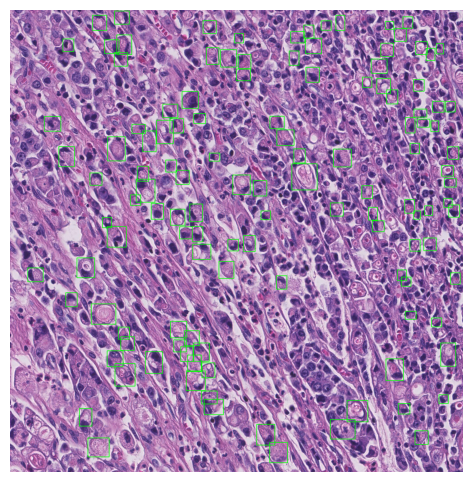

In [12]:
# Load annotation file
tree = ET.parse(gt_path)
root = tree.getroot()
filename = root.find('filename').text
size = root.find('size')
width = int(size.find('width').text)
height = int(size.find('height').text)
print(f"File: {filename}, Size: {width}x{height}")

# Extract all object info
print(f"Number of object: {len(root.findall('object'))}")
for obj in root.findall('object'):
    label = obj.find('name').text
    bbox = obj.find('bndbox')
    xmin = int(bbox.find('xmin').text)
    ymin = int(bbox.find('ymin').text)
    xmax = int(bbox.find('xmax').text)
    ymax = int(bbox.find('ymax').text)
    cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.axis('off')
plt.show()

### 2.2 Pre-processing function

In [13]:
def sliding_window(image, window_size=512, overlap=0.5):
    h, w = image.shape[:2]
    stride = int(window_size * (1 - overlap))

    # Calculate padding needed on right and bottom so windows fully cover the image
    pad_h = (stride - (h - window_size) % stride) % stride
    pad_w = (stride - (w - window_size) % stride) % stride

    # Pad the image with zeros (black) on bottom and right
    if len(image.shape) == 3:
        # Color image (H,W,C)
        padded_image = np.pad(image, ((0, pad_h), (0, pad_w), (0,0)), mode='constant', constant_values=0)
    else:
        # Grayscale (H,W)
        padded_image = np.pad(image, ((0, pad_h), (0, pad_w)), mode='constant', constant_values=0)

    padded_h, padded_w = padded_image.shape[:2]

    windows = []
    coords = []

    for y in range(0, padded_h - window_size + 1, stride):
        for x in range(0, padded_w - window_size + 1, stride):
            crop = padded_image[y:y+window_size, x:x+window_size]
            windows.append(crop)
            coords.append((x, y))

    return windows, coords

Generated 56 windows


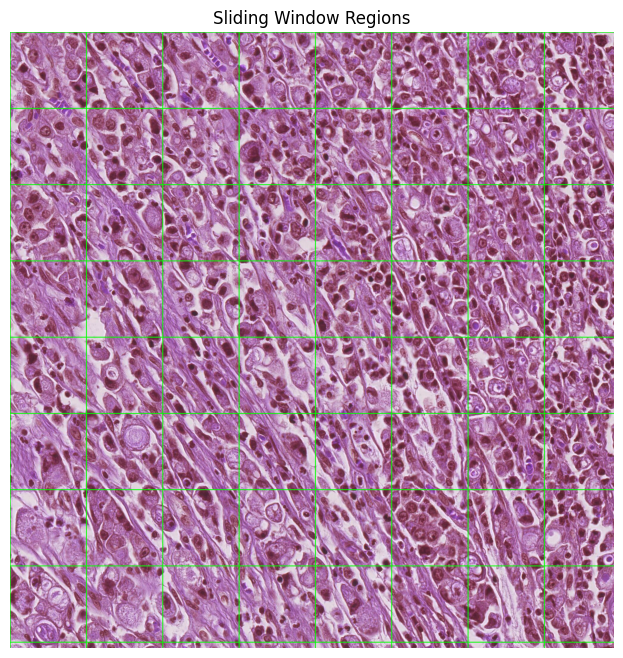

In [14]:
windows, coords = sliding_window(original_image, window_size=512, overlap=0.5)

print(f"Generated {len(windows)} windows")

# Show coordinates on the original image
image_copy = original_image.copy()
for (x,y) in coords:
    cv2.rectangle(image_copy, (x,y), (x+512, y+512), (0,255,0), 2)

plt.figure(figsize=(8,8))
plt.imshow(cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))
plt.title("Sliding Window Regions")
plt.axis('off')
plt.show()

## Model Usage

In [15]:
# Convert bounding boxes from (x, y, w, h) format to (x1, y1, x2, y2) format.
def boxes_conversion_xy(boxes_x1y1wh):
    """
    Args:
        boxes: A set of bounding boxes in (x, y, width, height) format

    Returns:
        torch.Tensor: Bounding boxes in (x1, y1, x2, y2) format as a float32 tensor.
                      (x1, y1) is the top-left corner, (x2, y2) is the bottom-right.
    """

    if isinstance(boxes_x1y1wh, torch.Tensor):
        boxes_x1y1x2y2 = boxes_x1y1wh.clone()
        boxes_x1y1x2y2[:, 2] = boxes_x1y1x2y2[:, 0] + boxes_x1y1x2y2[:, 2]  # x2 = x + w
        boxes_x1y1x2y2[:, 3] = boxes_x1y1x2y2[:, 1] + boxes_x1y1x2y2[:, 3]  # y2 = y + h
    else:
        boxes_x1y1wh = np.array(boxes_x1y1wh)
        boxes_x1y1x2y2 = boxes_x1y1wh.copy()
        boxes_x1y1x2y2[:, 2] = boxes_x1y1x2y2[:, 0] + boxes_x1y1x2y2[:, 2]
        boxes_x1y1x2y2[:, 3] = boxes_x1y1x2y2[:, 1] + boxes_x1y1x2y2[:, 3]
        boxes_x1y1x2y2 = torch.tensor(boxes_x1y1x2y2, dtype=torch.float32)

    return boxes_x1y1x2y2

def pred2box(hm, regr, thresh=0.99, MODEL_SCALE=4, input_size=512):
    pred = hm > thresh
    pred_center = np.where(pred)
    pred_r = regr[:, pred].T  # Shape: [N, 2] for w, h
    boxes = []
    scores = hm[pred]

    for i, b in enumerate(pred_r):
        cx = pred_center[1][i] * MODEL_SCALE
        cy = pred_center[0][i] * MODEL_SCALE

        w = b[0] * input_size
        h = b[1] * input_size

        x1 = cx - w /2
        y1 = cy - h /2

        arr = np.clip([x1, y1, w, h], 0, input_size)
        boxes.append(arr)

    return np.asarray(boxes), scores

def pool_numpy(data, size=3):
    max_filtered = maximum_filter(data, size=size, mode='constant')
    return np.where(data == max_filtered, data, 0)

def plot_pred(image, boxes_pred, pseudo_hm):
    # ----- Visualization ----- #
    # Copy image for drawing boxes
    image_copy = image.copy()

    # Draw predicted boxes in red (BGR format)
    for box in boxes_pred:
        x1, y1, w, h = map(int, box)
        cv2.rectangle(image_copy, (x1, y1), (x1 + w, y1 + h), (0, 0, 255), 2)

    # Create subplot
    fig, axs = plt.subplots(1, 2, figsize=(5, 3.5))

    # Display image with red boxes
    axs[0].imshow(cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))
    axs[0].set_title("Red: Predicted Boxes", fontsize=10)
    axs[0].axis('off')

    # Display heatmap
    axs[1].imshow(pseudo_hm, cmap='hot', interpolation='nearest', vmin=0, vmax=1)
    axs[1].set_title("Predicted Heatmap", fontsize=10)
    axs[1].axis('off')

    plt.tight_layout()
    plt.show()

def get_prediction(image, model):

  # Transfrom function
  transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                  std=[0.229, 0.224, 0.225])
          ])

  # Load windows
  windows, coords = sliding_window(image)
  all_boxes = []

  # Pass image in the model
  model.eval()
  with torch.no_grad():
      for crop, (x_offset, y_offset) in zip(windows, coords):

          # Image tensor
          input_tensor = transform(crop).unsqueeze(0).to(device)

          # Forward pass through the model
          hms_pred, regrs_pred = model(input_tensor)
          hms_pred = torch.sigmoid(hms_pred)

          # Preprocess predictions
          hms_pred = pool_numpy(hms_pred.cpu().numpy().squeeze(0).squeeze(0))
          regrs_pred = regrs_pred.cpu().numpy().squeeze(0)

          # Get predicted bounding boxes and scores from heatmap and regression output
          boxes, scores = pred2box(hms_pred, regrs_pred, 0.3)

          # Convert to tensors for NMS
          boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
          scores_tensor = torch.tensor(scores, dtype=torch.float32)

          # Apply Non-Maximum Suppression if any boxes are predicted
          if boxes_tensor.numel() > 0:
              boxes_xyxy = boxes_conversion_xy(boxes_tensor)
              keep = nms(boxes_xyxy, scores_tensor, iou_threshold=0.3)

              # Filter top boxes and scores
              boxes_sorted = boxes[keep.numpy()]
              scores_sorted = scores[keep.numpy()]

              #Visualize
              plot_pred(crop, boxes_sorted, hms_pred)

              # Adjust center coordinates to global image space
              boxes_sorted[:, 0] += x_offset  # x_center
              boxes_sorted[:, 1] += y_offset  # y_center
              all_boxes.append(boxes_sorted)

          else:
              # No predictions, initialize empty arrays
              all_boxes.append(np.empty((0, 4)))

      # Concatenate all predicted boxes from all windows
      all_boxes_np = np.concatenate(all_boxes, axis=0)
      boxes_xyxy = boxes_conversion_xy(all_boxes_np)

      # Apply NMS globally
      boxes_tensor = torch.tensor(boxes_xyxy, dtype=torch.float32)
      scores_tensor = torch.ones(len(boxes_tensor), dtype=torch.float32)
      keep = torchvision.ops.nms(boxes_tensor, scores_tensor, iou_threshold=0.3)

      # Final deduplicated boxes
      final_boxes = all_boxes_np[keep.numpy()]

      return final_boxes

### 3.1 Teacher model

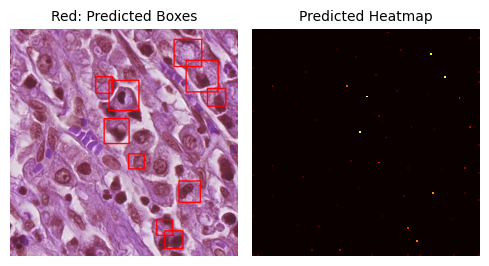

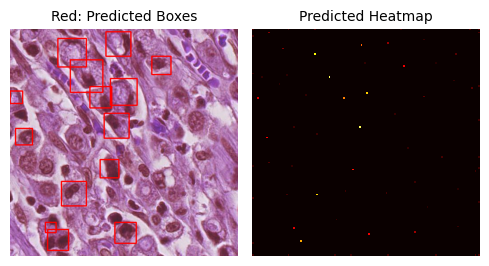

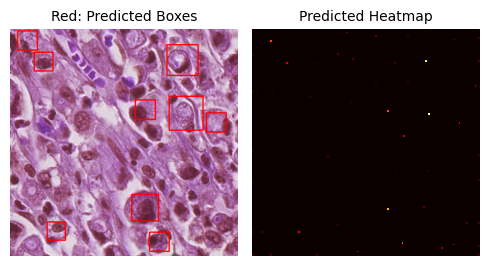

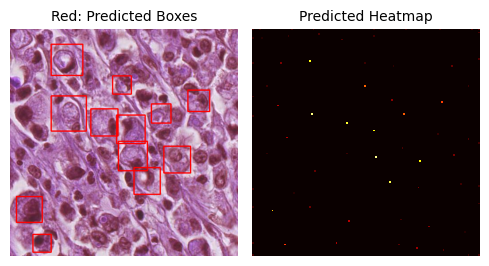

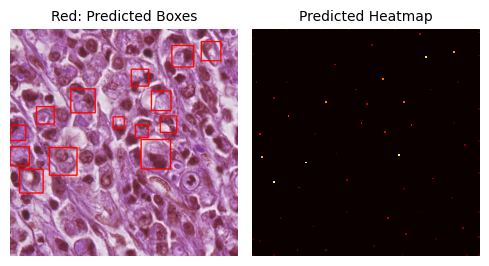

...

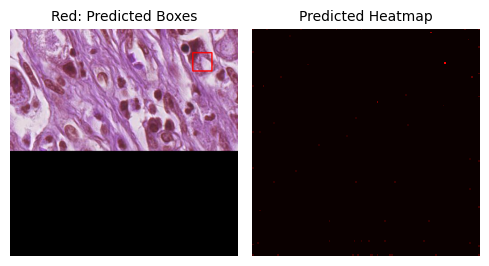

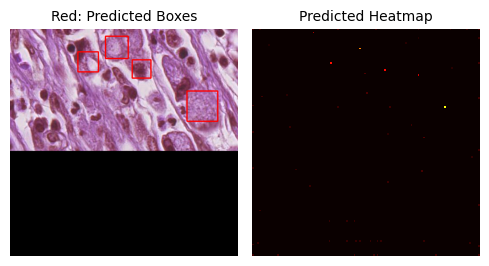

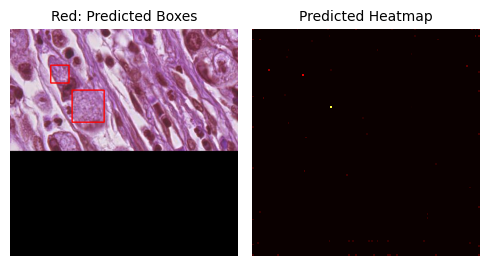

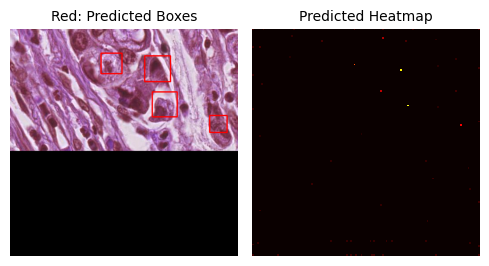

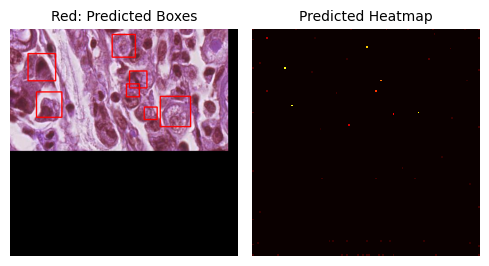

/tmp/ipython-input-15-1368007750.py:139: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  boxes_tensor = torch.tensor(boxes_xyxy, dtype=torch.float32)


In [16]:
teacher_boxes = get_prediction(original_image, teacher_model)

### 3.2 Baseline student model

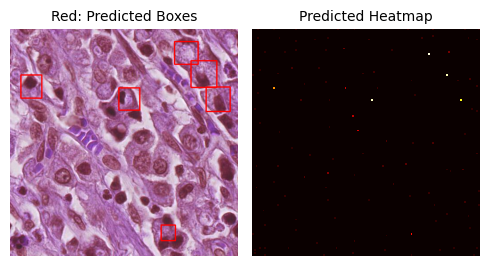

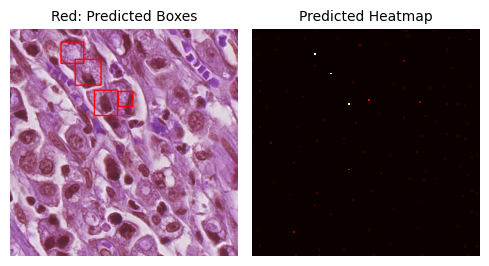

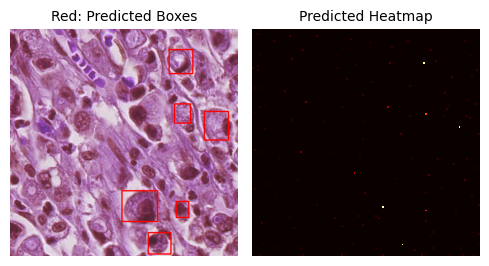

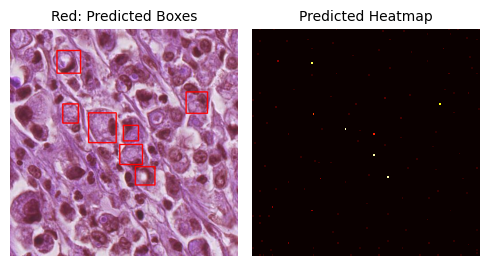

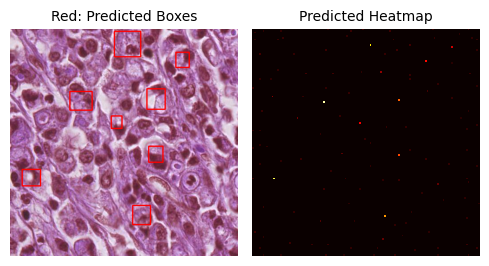

...

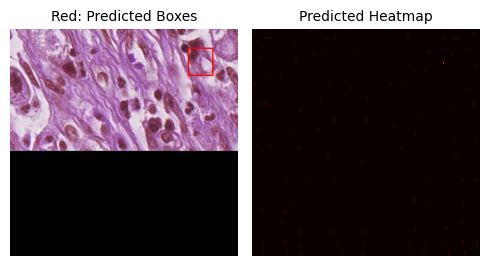

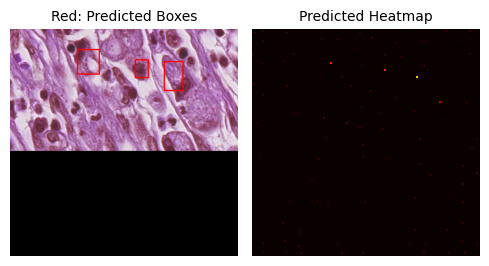

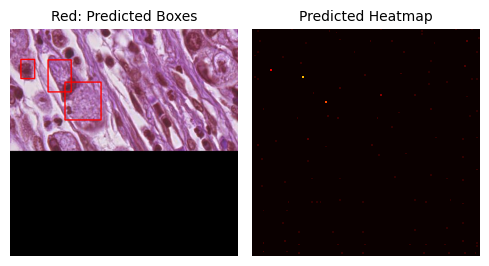

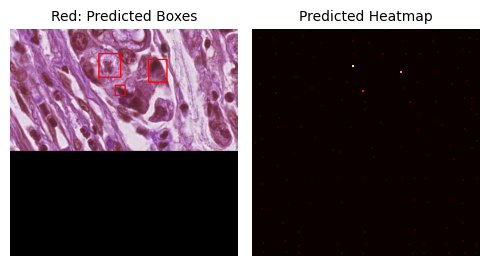

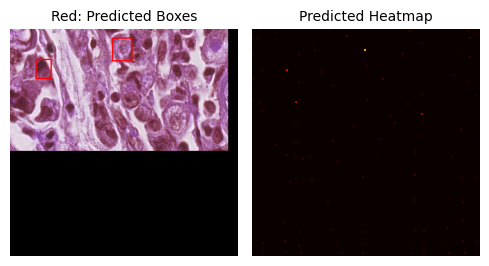

/tmp/ipython-input-15-1368007750.py:139: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  boxes_tensor = torch.tensor(boxes_xyxy, dtype=torch.float32)


In [17]:
baseline_student_boxes = get_prediction(original_image, baseline_student_model)

### 3.3 Student model

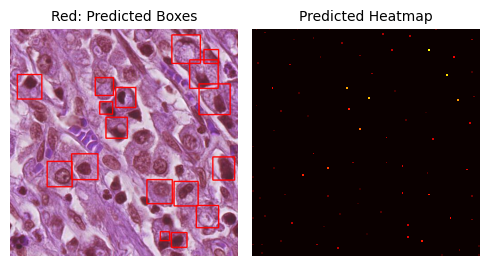

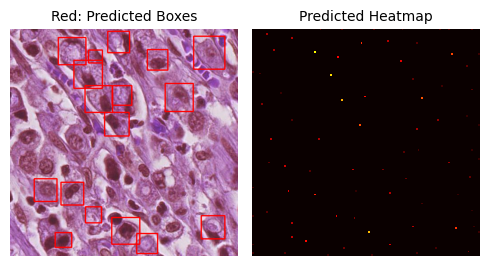

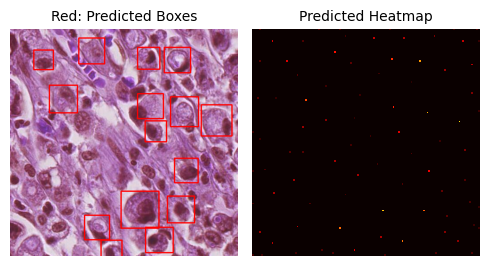

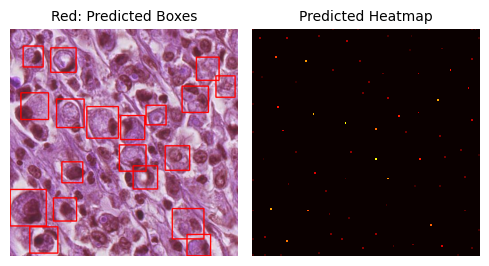

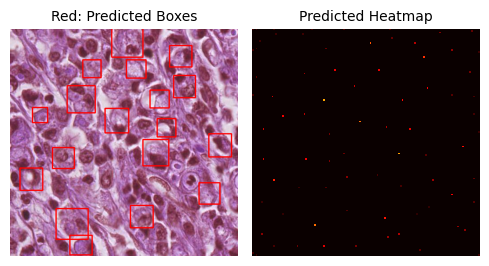

...

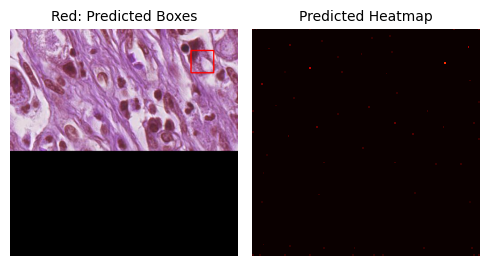

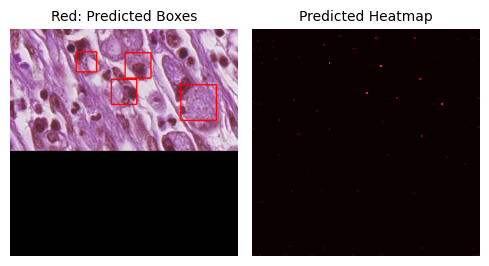

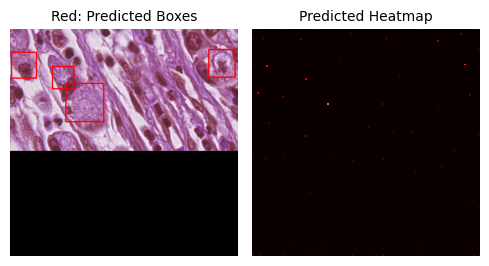

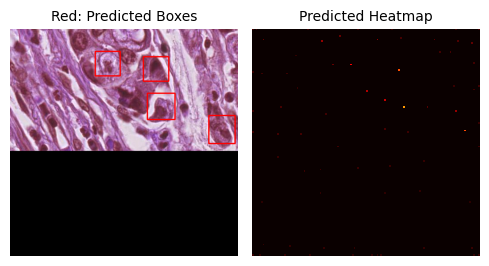

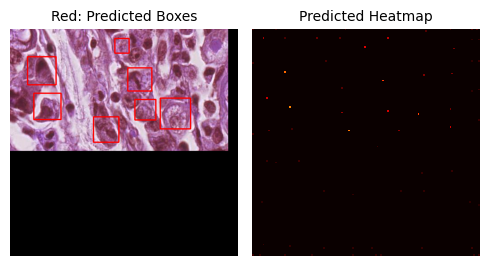

/tmp/ipython-input-15-1368007750.py:139: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  boxes_tensor = torch.tensor(boxes_xyxy, dtype=torch.float32)


In [18]:
student_boxes = get_prediction(original_image, student_model)

### 3.4 Visualization

In [19]:
def draw_boxes(image, gt_root, pred_boxes, color_gt=(0,255,0), color_pred=(0,0,255)):
    """
    Draws ground truth and predicted boxes on a copy of the image.
    - color_gt: Green
    - color_pred: Red
    """
    image_copy = image.copy()

    # Draw ground truth boxes
    for obj in gt_root.findall('object'):
        bbox = obj.find('bndbox')
        xmin = int(bbox.find('xmin').text)
        ymin = int(bbox.find('ymin').text)
        xmax = int(bbox.find('xmax').text)
        ymax = int(bbox.find('ymax').text)
        cv2.rectangle(image_copy, (xmin, ymin), (xmax, ymax), color_gt, 2)

    # Draw predicted boxes
    for box in pred_boxes:
        x1, y1, w, h = map(int, box)
        cv2.rectangle(image_copy, (x1, y1), (x1 + w, y1 + h), color_pred, 2)

    return cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB)

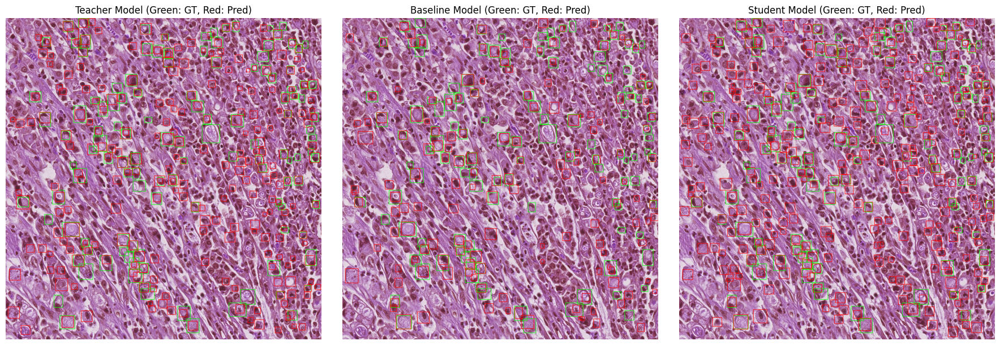

In [20]:
# Generate visualizations
img_teacher = draw_boxes(original_image, root, teacher_boxes)
img_baseline = draw_boxes(original_image, root, baseline_student_boxes)
img_student = draw_boxes(original_image, root, student_boxes)

# Plot
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(img_teacher)
plt.title("Teacher Model (Green: GT, Red: Pred)")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(img_baseline)
plt.title("Baseline Model (Green: GT, Red: Pred)")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(img_student)
plt.title("Student Model (Green: GT, Red: Pred)")
plt.axis('off')

plt.tight_layout()
plt.show()